<a href="https://colab.research.google.com/github/siddfulzele/Covid_19/blob/master/Covid_19.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import requests
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
import plotly.express as px
import plotly.graph_objects as go
from matplotlib.pylab import rcParams
%matplotlib inline
rcParams['figure.figsize'] = 10,6

In [ ]:
#LOADING RAW DATA
'''
Raw data 1 Data till EoD Apr 19th
Raw data 2 Data till EoD Apr 26th
Raw data 3 Data till EoD May 9th
Raw data 4 Data Live
'''

raw_data = pd.DataFrame()
for i in range(1,5):
    res_data = requests.get("https://api.covid19india.org/raw_data"+str(i)+".json")
    call_data = res_data.json()
    nl_data = pd.DataFrame(call_data['raw_data'])    
    raw_data = raw_data.append(nl_data)

print(raw_data.shape)

(56423, 22)


In [ ]:
#LOADING DATA - National Level :Time series, State-wise stats and Test counts
res_NL = requests.get("https://api.covid19india.org/data.json")
call_NL = res_NL.json()
nl_ts = pd.DataFrame(call_NL['cases_time_series'])
nl_tc = pd.DataFrame(call_NL['tested'])
nl_sw = pd.DataFrame(call_NL['statewise'])

In [ ]:
#LOADING DATA - State Level : Testing data
res_SLT = requests.get("https://api.covid19india.org/state_test_data.json")
call_SLT = res_SLT.json()
slt = pd.DataFrame(call_SLT['states_tested_data'])

In [ ]:
print("Rows and colums of time series : ",nl_ts.shape)
print("Rows and colums of tested data : ",nl_tc.shape)
print("Rows and colums of state wise data : ",nl_sw.shape)

Rows and colums of time series :  (134, 7)
Rows and colums of tested data :  (94, 12)
Rows and colums of state wise data :  (38, 12)


In [ ]:
print("colum names : ",list(nl_tc))


colum names :  ['individualstestedperconfirmedcase', 'positivecasesfromsamplesreported', 'samplereportedtoday', 'source', 'testpositivityrate', 'testsconductedbyprivatelabs', 'testsperconfirmedcase', 'testspermillion', 'totalindividualstested', 'totalpositivecases', 'totalsamplestested', 'updatetimestamp']


# **Trends Analysis**

In [ ]:
#melt function help us to reshape data
daily = nl_ts.melt(id_vars='date', value_vars=['dailyconfirmed','dailydeceased','dailyrecovered'])
daily.replace('dailyconfirmed','Confirmed',inplace=True)
daily.replace('dailydeceased','Deceased',inplace=True)
daily.replace('dailyrecovered','Recovered',inplace=True)
daily.columns = ['Date','Status','Count']
#px.line(daily, x='Date' , y='Count' , color='Status')

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Bar(x = nl_ts.date , y = nl_ts.dailyconfirmed , name = 'Confirmed')
)
fig.add_trace(
    go.Bar(x = nl_ts.date , y = nl_ts.dailydeceased , name = 'Deceased')
)
fig.add_trace(
    go.Bar(x = nl_ts.date , y = nl_ts.dailyrecovered , name = 'Recovered')
)
fig.update_layout(
    title="Spread Trends - Daily ",
    xaxis_title="Date",
    yaxis_title="Count",
    font=dict(
        family="Courier New, monospace",
        size=14,
    )
)
fig.show()

In [ ]:
nl_ts[nl_ts.date == '01 June ']

,dailyconfirmed,dailydeceased,dailyrecovered,date,totalconfirmed,totaldeceased,totalrecovered
123,7723,201,3882,01 June,198372,5607,95744


In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Scatter(x = nl_ts.date , y = nl_ts.totalconfirmed , name = 'Confirmed')
)
fig.add_trace(
    go.Scatter(x = nl_ts.date , y = nl_ts.totaldeceased , name = 'Deceased')
)
fig.add_trace(
    go.Scatter(x = nl_ts.date , y = nl_ts.totalrecovered , name = 'Recovered')
)
fig.update_layout(
    title="Spread Trends - Cumulative",
    xaxis_title="Date",
    yaxis_title="Count",
    font=dict(
        family="Courier New, monospace",
        size=14,
    )
)
fig.add_shape(
    dict(
        type="line",
        x0='22 March ',
        y0=0,
        x1='22 March ',
        y1=250000,        
        line=dict(
            color="black",
            width=2
        )
))
fig.add_annotation(
            x='22 March ',
            y=250000,
            text="Phase 1")
fig.add_shape(
    dict(
        type="line",
        x0='15 April ',
        y0=0,
        x1='15 April ',
        y1=250000,        
        line=dict(
            color="black",
            width=2
        )
))
fig.add_annotation(
            x='15 April ',
            y=250000,
            text="Phase 2")
fig.add_shape(
    dict(
        type="line",
        x0='04 May ',
        y0=0,
        x1='04 May ',
        y1=250000,        
        line=dict(
            color="black",
            width=2
        )
))
fig.add_annotation(
            x='04 May ',
            y=250000,
            text="Phase 3")
fig.add_shape(
    dict(
        type="line",
        x0='18 May ',
        y0=0,
        x1='18 May ',
        y1=250000,        
        line=dict(
            color="black",
            width=2
        )
))
fig.add_annotation(
            x='18 May ',
            y=250000,
            text="Phase 4")
fig.add_shape(
    dict(
        type="line",
        x0='01 June ',
        y0=0,
        x1='01 June ',
        y1=250000,        
        line=dict(
            color="black",
            width=2
        )
))
fig.add_annotation(
            x='01 June ',
            y=250000,
            text="Phase 5")

fig.show()

# **Mortality Rate**

In [ ]:
#MORTALITY RATE 
mr = nl_ts.tail(1).iloc[0]
print("Type : ",type(mr))
ta = int(mr['totalconfirmed']) - (int(mr['totaldeceased']) + int(mr["totalrecovered"]))
mr = mr.append(pd.Series({"totalActive" : ta}))
print("Last Updated : ",mr.date)

Type :  <class 'pandas.core.series.Series'>
Last Updated :  11 June 


In [ ]:
fig = go.Figure(go.Pie(
    values = [mr.totalrecovered,mr.totaldeceased,mr.totalActive],
    labels = ['Recovered','Death','Active'],
    texttemplate = "%{label}: %{value} <br>(%{percent})",
    textposition = "inside",
    pull=[0, 0.2, 0])
)

fig.update_traces(
    marker=dict(colors=['LightGreen','FireBrick','DeepSkyBlue'])
)

fig.update_layout(
    height = 800,        
    title="MORTALITY RATE ",
    font=dict(
        family="Courier New, monospace",
        size=18,
    )
)

fig.show()

# **State Wise Comparison**

In [ ]:
nl_sw = nl_sw.drop([0])

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Bar(x = nl_sw.statecode , y = nl_sw.confirmed , name = 'Confirmed')
)
fig.add_trace(
    go.Bar(x = nl_sw.statecode , y = nl_sw.deaths , name = 'Deceased')
)
fig.add_trace(
    go.Bar(x = nl_sw.statecode , y = nl_sw.recovered , name = 'Recovered')
)
fig.update_layout(
    title="State Comparison - Comulative",
    xaxis_title="State Code",
    yaxis_title="Count",
    font=dict(
        family="Courier New, monospace",
        size=14,
    )
)
fig.show()

# **Testing Process**

In [ ]:
list(nl_tc)

['individualstestedperconfirmedcase',
 'positivecasesfromsamplesreported',
 'samplereportedtoday',
 'source',
 'testpositivityrate',
 'testsconductedbyprivatelabs',
 'testsperconfirmedcase',
 'testspermillion',
 'totalindividualstested',
 'totalpositivecases',
 'totalsamplestested',
 'updatetimestamp']

In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Bar(x = nl_tc.updatetimestamp , y = nl_tc.totalsamplestested , name = 'Tested')
)

fig.update_layout(
    title="Teste - Daily",
    xaxis_title="Date",
    yaxis_title="Count",
    font=dict(
        family="Courier New, monospace",
        size=14,
    )
)
fig.show()

# **State Wise Daily Count**

In [ ]:
res_SD = requests.get("https://api.covid19india.org/states_daily.json")
call_SD = res_SD.json()
sd_data = pd.DataFrame(call_SD['states_daily'])

In [ ]:
sd_data_c = sd_data[sd_data.status == "Confirmed"]

In [ ]:
sd_data_c.tail()

,an,ap,ar,as,br,ch,ct,date,dd,dl,dn,ga,gj,hp,hr,jh,jk,ka,kl,la,ld,mh,ml,mn,mp,mz,nl,or,pb,py,rj,sk,status,tg,tn,tr,tt,un,up,ut,wb
255,0,199,3,208,239,2,150,07-Jun-20,0,1282,1,33,480,11,496,75,620,239,107,4,0,3007,3,15,173,10,9,75,93,12,262,0,Confirmed,154,1515,53,10882,418,433,52,449
258,0,154,6,154,177,6,124,08-Jun-20,0,1007,2,30,477,10,406,187,198,308,91,0,0,2554,3,100,237,8,6,138,55,9,277,0,Confirmed,92,1562,38,8536,-773,411,56,426
261,1,69,0,215,208,6,14,09-Jun-20,0,1366,2,29,470,16,355,126,61,161,91,5,0,2258,4,32,211,46,5,146,56,4,369,6,Confirmed,178,1685,26,9981,874,388,126,372
264,1,365,4,235,243,2,51,10-Jun-20,0,1501,5,28,510,14,370,135,161,120,65,7,0,3254,1,7,200,5,1,110,86,12,355,0,Confirmed,191,1927,31,11156,516,275,25,343
267,3,182,6,145,250,4,136,11-Jun-20,0,1877,1,30,513,19,389,48,67,204,83,20,0,3607,0,55,192,9,2,136,82,13,238,0,Confirmed,209,1875,18,11128,-296,478,93,440


In [ ]:
sd_data_c = sd_data_c.drop(['status','tt'],axis=1)

In [ ]:
y = sd_data_c.iloc[:,7].tolist()
sd_data_c = sd_data_c.drop('date',axis=1)

In [ ]:
x = list(sd_data_c)

In [ ]:
z = sd_data_c.values

In [ ]:
fig = go.Figure(go.Surface(
    contours = {
        "x": {"show": True, "start": 1.5, "end": 2, "size": 0.04, "color":"white"},
        "z": {"show": True, "start": 0.5, "end": 0.8, "size": 0.05}
    },
    x = x,
    y = y,
    z = z))
fig.update_layout(
        scene = {
            "xaxis": {"nticks": 20},
            "zaxis": {"nticks": 4},
            'camera_eye': {"x": 0, "y": -1, "z": 0.5},
            "aspectratio": {"x": 1, "y": 1, "z": 0.2}
        },
        title="State Wise Daily Count",
        font=dict(
            family="Courier New, monospace",
            size=14,
        )
)
fig.show()

# **Patients by Age**

In [ ]:
list(raw_data)

['agebracket',
 'backupnotes',
 'contractedfromwhichpatientsuspected',
 'currentstatus',
 'dateannounced',
 'detectedcity',
 'detecteddistrict',
 'detectedstate',
 'estimatedonsetdate',
 'gender',
 'nationality',
 'notes',
 'numcases',
 'patientnumber',
 'source1',
 'source2',
 'source3',
 'statecode',
 'statepatientnumber',
 'statuschangedate',
 'typeoftransmission',
 'entryid']

In [ ]:
raw_data.currentstatus.unique()

array(['Recovered', 'Hospitalized', 'Deceased', 'Migrated',
       'Migrated_Other', ''], dtype=object)

In [ ]:
age =  raw_data.agebracket[(raw_data.agebracket != "")]
age.isnull().sum()

0

In [ ]:
age = age[age != '28-35'] #UNWANTED DATA
age = age[age != '0'] #UNWANTED DATA
age = age[age != '6 Months'] #UNWANTED DATA

In [ ]:
age.unique()

array(['20', '45', '24', '69', '55', '70', '16', '27', '59', '65', '75',
       '54', '53', '61', '25', '63', '46', '3', '48', '40', '47', '13',
       '96', '89', '85', '68', '26', '33', '76', '37', '43', '21', '42',
       '44', '51', '31', '32', '29', '67', '49', '52', '22', '18', '34',
       '28', '56', '35', '50', '30', '38', '23', '19', '58', '41', '2',
       '60', '74', '39', '17', '36', '57', '64', '81', '62', '73', '9',
       '7', '66', '12', '1', '14', '11', '6', '92', '72', '15', '77',
       '10', '80', '71', '78', '79', '90', '4', '8', '5', '1.5', '0.4',
       '0.3', '88', '98', '83', '82', '84', '2.5', '87', '86', '0.2',
       '0.7', '29.6', '0.1', '3.5', '95', '94', '99', '0.5', '91', '93',
       '0.9', '0.25'], dtype=object)

In [ ]:
age = age.astype(float) #COVERT VALUES TO FLOAT

In [ ]:
age_data = pd.DataFrame()
age_data['Age'] = age

In [ ]:
bins = [x for x in range(0,101,10)]
print(bins)
g_labels = ['0-10','11-20','21-30','31-40','41-50','51-60','61-70','71-80','81-90','91-100']
print(g_labels)

[0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
['0-10', '11-20', '21-30', '31-40', '41-50', '51-60', '61-70', '71-80', '81-90', '91-100']


In [ ]:
age_data['group'] = pd.cut(age,bins,labels=g_labels)

In [ ]:
age_data = age_data[age_data.Age != 0]

In [ ]:
age_data.head()

,Age,group
0,20.0,11-20
3,45.0,41-50
4,24.0,21-30
5,69.0,61-70
6,55.0,51-60


In [ ]:
plt_age = age_data.Age.groupby(age_data.group).count()
plt_age

group
0-10      1059
11-20     2099
21-30     4926
31-40     4376
41-50     3121
51-60     2239
61-70     1084
71-80      379
81-90       87
91-100      11
Name: Age, dtype: int64

In [ ]:
smp_size = age_data.Age.count()
print(smp_size)

19381


In [ ]:
age_fig = go.Figure()
age_fig.add_trace(
    go.Bar(x=plt_age.index, y = plt_age, name = 'Age')
)
age_fig.update_layout(
    title="Age Comparison - Sample Size "+str(smp_size),
    xaxis_title="Age",
    yaxis_title="Cases",
    font=dict(
        family="Courier New, monospace",
        size=14,
    )
)
age_fig.show()

# **Gender Comparison**

In [ ]:
gen = raw_data[['gender']]
gen.count()

gender    56423
dtype: int64

In [ ]:
gen = gen[gen != '']
gen = gen[gen != 'NA']
gen.count()

gender    21936
dtype: int64

In [ ]:
type(gen)

pandas.core.frame.DataFrame

In [ ]:
gen = gen.groupby(['gender']).size().reset_index(name='counts')

In [ ]:
gen

,gender,counts
0,F,7536
1,M,14398
2,Non-Binary,2


In [ ]:
gen_fig = go.Figure(go.Pie(
    values = gen.counts,
    labels = ['Females','Males'],
    texttemplate = "%{label}: %{value} <br>(%{percent})",
    textposition = "inside",
    pull=[0, 0])
)

gen_fig.update_traces(
    marker=dict(colors=['LightGreen','FireBrick','DeepSkyBlue'])
)

gen_fig.update_layout(
    height = 600,        
    title="AGE COMPARISON - SAMPLE SIZE "+str(gen.counts.sum()),
    font=dict(
        family="Courier New, monospace",
        size=18,
    )
)

gen_fig.show()

# **death rate state wise**

In [ ]:
list(nl_sw)

['active',
 'confirmed',
 'deaths',
 'deltaconfirmed',
 'deltadeaths',
 'deltarecovered',
 'lastupdatedtime',
 'migratedother',
 'recovered',
 'state',
 'statecode',
 'statenotes']

In [ ]:
nl_sw['death_rate'] = nl_sw['deaths'].astype(int) / nl_sw['confirmed'].astype(int)

In [ ]:
nl_sw['death_rate'] = nl_sw['death_rate'] * 100

In [ ]:
nl_sw[['state','confirmed','deaths','death_rate','statecode']]

,state,confirmed,deaths,death_rate,statecode
1,Maharashtra,97648,3590,3.676471,MH
2,Tamil Nadu,40698,367,0.901764,TN
3,Delhi,34687,1085,3.127973,DL
4,Gujarat,22067,1385,6.276340,GJ
5,Uttar Pradesh,12088,345,2.854070,UP
6,Rajasthan,11930,269,2.254820,RJ
7,Madhya Pradesh,10241,431,4.208573,MP
8,West Bengal,9768,442,4.524980,WB
9,State Unassigned,8315,0,0.000000,UN
10,Karnataka,6516,72,1.104972,KA


In [ ]:
nl_sw = nl_sw.sort_values('death_rate', ascending=False)
dr_fig = go.Figure()
dr_fig.add_trace(
    go.Bar(x=nl_sw.statecode, y = nl_sw.death_rate, name = 'Death Rate')
)
dr_fig.update_layout(
    title="Death Rate Comparison - State Wise ",
    xaxis_title="State",
    yaxis_title="Death Rate",
    font=dict(
        family="Courier New, monospace",
        size=14,
    )
)
dr_fig.show()

In [ ]:
dr_fig = px.bar(nl_sw.sort_values('death_rate', ascending=False), x="statecode", y="death_rate", title='Deate Rate')
dr_fig.show()

# **Recovry Rate**

In [ ]:
nl_sw[['state','confirmed','deaths','death_rate','statecode']]

,state,confirmed,deaths,death_rate,statecode
4,Gujarat,22067,1385,6.276340,GJ
8,West Bengal,9768,442,4.524980,WB
7,Madhya Pradesh,10241,431,4.208573,MP
15,Telangana,4320,165,3.819444,TG
1,Maharashtra,97648,3590,3.676471,MH
3,Delhi,34687,1085,3.127973,DL
5,Uttar Pradesh,12088,345,2.854070,UP
33,Meghalaya,44,1,2.272727,ML
6,Rajasthan,11930,269,2.254820,RJ
18,Punjab,2887,59,2.043644,PB


In [ ]:
nl_sw['recovry_rate'] = nl_sw['recovered'].astype(int) / nl_sw['confirmed'].astype(int)
nl_sw['recovry_rate'] = nl_sw['recovry_rate'] * 100

In [ ]:
rr_fig = px.bar(nl_sw.sort_values('recovry_rate', ascending=False), x="statecode", y="recovry_rate", title='Recovry Rate')
rr_fig.show()

# **Map**

In [ ]:
print(list(nl_sw))
nl_sw[nl_sw.statecode == "UN"]
map_data = nl_sw[["state","statecode","confirmed"]]
map_data = map_data[map_data.state != "State Unassigned"]
map_data.head()
nl_sw[nl_sw.statecode == "UN"]

['active', 'confirmed', 'deaths', 'deltaconfirmed', 'deltadeaths', 'deltarecovered', 'lastupdatedtime', 'migratedother', 'recovered', 'state', 'statecode', 'statenotes', 'death_rate', 'recovry_rate']


,active,confirmed,deaths,deltaconfirmed,deltadeaths,deltarecovered,lastupdatedtime,migratedother,recovered,state,statecode,statenotes,death_rate,recovry_rate
9,9227,9227,0,516,0,0,10/06/2020 10:04:48,0,0,State Unassigned,UN,"""MoHFW website reports that these are the """"ca...",0.0,0.0


In [ ]:
import shapefile as shp
import seaborn as sns

In [ ]:
sns.set(style="whitegrid", palette="pastel", color_codes=True) 
sns.mpl.rc("figure", figsize=(5,3))

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
!pwd

/content


In [ ]:
#opening the vector map
shp_path = "/content/drive/My Drive/Colab Datasets/in_map/Indian_States.shp"
#reading the shape file by using reader function of the shape lib
sf = shp.Reader(shp_path)

In [ ]:
len(sf.shapes())

36

In [ ]:
sf.records()

[Record #0: ['Andaman & Nicobar Island'],
 Record #1: ['Arunanchal Pradesh'],
 Record #2: ['Assam'],
 Record #3: ['Bihar'],
 Record #4: ['Chandigarh'],
 Record #5: ['Chhattisgarh'],
 Record #6: ['Dadara & Nagar Havelli'],
 Record #7: ['Daman & Diu'],
 Record #8: ['Goa'],
 Record #9: ['Gujarat'],
 Record #10: ['Haryana'],
 Record #11: ['Himachal Pradesh'],
 Record #12: ['Jammu & Kashmir'],
 Record #13: ['Jharkhand'],
 Record #14: ['Karnataka'],
 Record #15: ['Kerala'],
 Record #16: ['Lakshadweep'],
 Record #17: ['Madhya Pradesh'],
 Record #18: ['Maharashtra'],
 Record #19: ['Manipur'],
 Record #20: ['Meghalaya'],
 Record #21: ['Mizoram'],
 Record #22: ['Nagaland'],
 Record #23: ['NCT of Delhi'],
 Record #24: ['Puducherry'],
 Record #25: ['Punjab'],
 Record #26: ['Rajasthan'],
 Record #27: ['Sikkim'],
 Record #28: ['Tamil Nadu'],
 Record #29: ['Telangana'],
 Record #30: ['Tripura'],
 Record #31: ['Uttar Pradesh'],
 Record #32: ['Uttarakhand'],
 Record #33: ['West Bengal'],
 Record #34: [

In [ ]:
map_data.state

4                                      Gujarat
8                                  West Bengal
7                               Madhya Pradesh
15                                   Telangana
1                                  Maharashtra
3                                        Delhi
6                                Uttar Pradesh
33                                   Meghalaya
5                                    Rajasthan
18                                      Punjab
24                            Himachal Pradesh
26                                  Chandigarh
13                              Andhra Pradesh
10                                   Karnataka
14                           Jammu and Kashmir
20                                 Uttarakhand
12                                     Haryana
2                                   Tamil Nadu
30                                      Ladakh
19                                      Kerala
11                                       Bihar
21           

In [ ]:
def read_shapefile(sf):
    #fetching the headings from the shape file
    fields = [x[0] for x in sf.fields][1:]#fetching the records from the shape file
    records = [list(i) for i in sf.records()]
    shps = [s.points for s in sf.shapes()]#converting shapefile data into pandas dataframe
    df = pd.DataFrame(columns=fields, data=records)#assigning the coordinates
    df = df.assign(coords=shps)
    return df

In [ ]:
df = read_shapefile(sf)
df.shape

(36, 2)

In [ ]:
df.sample(5)

,st_nm,coords
15,Kerala,"[(74.99575065337001, 12.79226798218167), (75.0..."
18,Maharashtra,"[(73.4627026845813, 16.037102338202374), (73.4..."
29,Telangana,"[(81.0561367328126, 17.79096593023613), (81.05..."
21,Mizoram,"[(92.80022352819333, 24.416297645320128), (92...."
17,Madhya Pradesh,"[(74.17931649066355, 22.39058566869369), (74.1..."


In [ ]:
def plot_map(sf, x_lim = None, y_lim = None, figsize = (11,9)):
    plt.figure(figsize = figsize)
    id=0
    for shape in sf.shapeRecords():
        x = [i[0] for i in shape.shape.points[:]]
        y = [i[1] for i in shape.shape.points[:]]
        plt.plot(x, y, 'k')
        
        if (x_lim == None) & (y_lim == None):
            x0 = np.mean(x)
            y0 = np.mean(y)
            plt.text(x0, y0, id, fontsize=10)
        id = id+1
    
    if (x_lim != None) & (y_lim != None):     
        plt.xlim(x_lim)
        plt.ylim(y_lim)

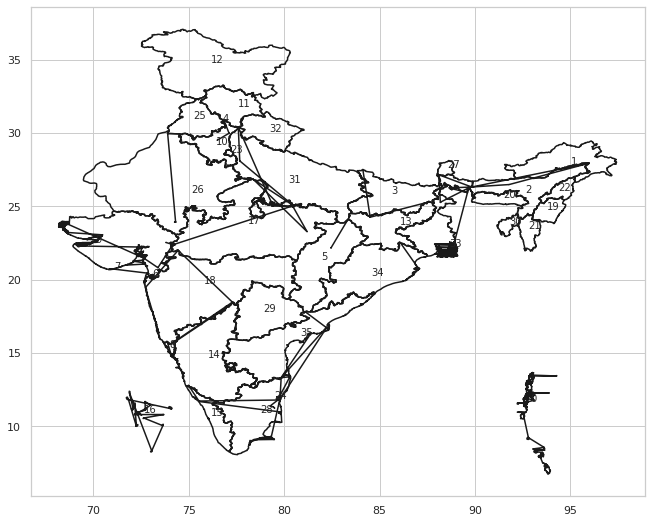

In [ ]:
#calling the function and passing required parameters to plot the full map
plot_map(sf)

In [ ]:
def calc_color(data, color=None):
        if color   == 1: 
            color_sq =  ['#dadaebFF','#bcbddcF0','#9e9ac8F0','#807dbaF0','#6a51a3F0','#54278fF0']; 
            colors = 'Purples';
        elif color == 2: 
            color_sq = ['#c7e9b4','#7fcdbb','#41b6c4','#1d91c0','#225ea8','#253494']; 
            colors = 'YlGnBu';
        elif color == 3: 
            color_sq = ['#f7f7f7','#d9d9d9','#bdbdbd','#969696','#636363','#252525']; 
            colors = 'Greys';
        elif color == 9: 
            color_sq = ['#ff0000','#ff0000','#ff0000','#ff0000','#ff0000','#ff0000'];
                        
        else:           
            color_sq = ['#ffffd4','#fee391','#fec44f','#fe9929','#d95f0e','#993404']; 
            colors = 'YlOrBr';
        new_data, bins = pd.qcut(data, 6, retbins=True, 
        labels=list(range(6)))
        color_ton = []
        for val in new_data:
            color_ton.append(color_sq[val]) 
        if color != 9:
            colors = sns.color_palette(colors, n_colors=6)
            sns.palplot(colors, 0.6);
            for i in range(6):
                print ("\n"+str(i+1)+': '+str(int(bins[i]))+
                       " => "+str(int(bins[i+1])-1))
            print("\n\n   1   2   3   4   5   6")    
        return color_ton, bins;

In [ ]:
def plot_map_fill_multiples_ids_tone(sf, title, city,  
                                     print_id, color_ton, 
                                     bins, 
                                     x_lim = None, 
                                     y_lim = None, 
                                     figsize = (11,9)):
   
        
    plt.figure(figsize = figsize)
    fig, ax = plt.subplots(figsize = figsize)
    fig.suptitle(title, fontsize=16)
    for shape in sf.shapeRecords():
        x = [i[0] for i in shape.shape.points[:]]
        y = [i[1] for i in shape.shape.points[:]]
        ax.plot(x, y, 'k')
            
    for id in city:
        shape_ex = sf.shape(id)
        x_lon = np.zeros((len(shape_ex.points),1))
        y_lat = np.zeros((len(shape_ex.points),1))
        for ip in range(len(shape_ex.points)):
            x_lon[ip] = shape_ex.points[ip][0]
            y_lat[ip] = shape_ex.points[ip][1]
        ax.fill(x_lon,y_lat, color_ton[city.index(id)])
        if print_id != False:
            x0 = np.mean(x_lon)
            y0 = np.mean(y_lat)
            plt.text(x0, y0, id, fontsize=10)
    if (x_lim != None) & (y_lim != None):     
        plt.xlim(x_lim)
        plt.ylim(y_lim)

In [ ]:
def plot_cities_data(sf, title, cities, data=None,color=None, print_id=False):
 
    color_ton, bins = calc_color(data, color)
    df = read_shapefile(sf)
    city_id = []
    for i in cities:
        city_id.append(df[df.st_nm == 
                            i.upper()].index)
    plot_map_fill_multiples_ids_tone(sf, title, city_id, 
                                     print_id, 
                                     color_ton, 
                                     bins, 
                                     x_lim = None, 
                                     y_lim = None, 
                                     figsize = (11,9));

In [ ]:
map_data.confirmed = map_data.confirmed.astype(int)

In [ ]:
map_data.state = map_data.state.str.strip()


1: 0 => 86

2: 87 => 366

3: 367 => 1861

4: 1862 => 4752

5: 4753 => 10306

6: 10307 => 94040


   1   2   3   4   5   6


TypeError: ignored

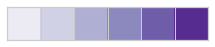

<Figure size 792x648 with 0 Axes>

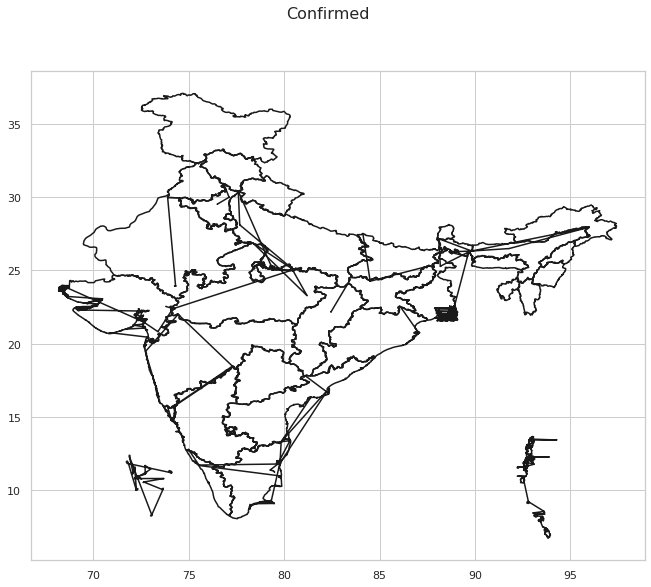

In [ ]:
plot_cities_data(sf,"Confirmed",map_data.state,map_data.confirmed,1,True)

# **Test 2**

In [ ]:
import geopandas as gpd
import folium
from branca.colormap import linear

In [ ]:
gdf= gpd.read_file('/content/drive/My Drive/Colab Datasets/in_map/india_states.geojson')
gdf.head()

,ID_0,ISO,NAME_0,ID_1,NAME_1,NL_NAME_1,VARNAME_1,TYPE_1,ENGTYPE_1,filename,filename_1,filename_2,filename_3,filename_4,geometry
0,105,IND,India,1,Andaman and Nicobar,,Andaman & Nicobar Islands|Andaman et Nicobar|I...,Union Territor,Union Territory,,,,,,"MULTIPOLYGON (((93.78773 6.85264, 93.78849 6.8..."
1,105,IND,India,2,Andhra Pradesh,,,State,State,,,,,,"MULTIPOLYGON (((80.27458 13.45958, 80.27458 13..."
2,105,IND,India,3,Arunachal Pradesh,,Agence de la Frontire du Nord-Est(French-obsol...,State,State,,,,,,"POLYGON ((96.15778 29.38310, 96.16380 29.37668..."
3,105,IND,India,4,Assam,,,State,State,,,,,,"MULTIPOLYGON (((89.87145 25.53730, 89.87118 25..."
4,105,IND,India,5,Bihar,,,State,State,,,,,,"MULTIPOLYGON (((88.10548 26.53904, 88.10505 26..."


In [ ]:
gdf.shape

(35, 15)

In [ ]:
gdf.columns

Index(['ID_0', 'ISO', 'NAME_0', 'ID_1', 'NAME_1', 'NL_NAME_1', 'VARNAME_1',
       'TYPE_1', 'ENGTYPE_1', 'filename', 'filename_1', 'filename_2',
       'filename_3', 'filename_4', 'geometry'],
      dtype='object')

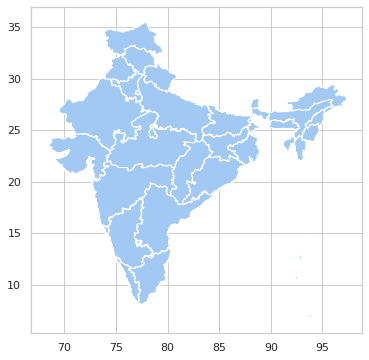

In [ ]:
gdf.plot()

In [ ]:
my_map= folium.Map([12.9724, 77.5806], zoom_start=11)

folium.GeoJson(gdf).add_to(my_map)

#my_map.save("my_first_map.html")
my_map

In [ ]:
colormap = linear.YlGn_09.scale(map_data.confirmed.min(), map_data.confirmed.max())
print(colormap(6.0))
colormap

#ffffe5ff


In [ ]:
pop_dict=map_data.set_index('state')['confirmed']

In [ ]:
pop_dict

state
Gujarat                                     21554
West Bengal                                  9328
Madhya Pradesh                              10049
Telangana                                    4111
Maharashtra                                 94041
Delhi                                       32810
Uttar Pradesh                               11610
Meghalaya                                      44
Rajasthan                                   11600
Punjab                                       2805
Himachal Pradesh                              451
Chandigarh                                    328
Andhra Pradesh                               5247
Karnataka                                    6041
Jammu and Kashmir                            4507
Uttarakhand                                  1562
Haryana                                      5579
Tamil Nadu                                  36841
Ladakh                                        115
Kerala                                      

In [ ]:
def style_function(feature):
    pop_d = pop_dict.get(int(feature['id']), None)
    return {
        'fillColor': '#black' if pop_d is None else colormap(pop_d),
        'color': 'black',
        'weight': 1,
        'dashArray': '5, 5',
        'fillOpacity': 0.9,
    }

In [ ]:
map_data = map_data.sort_values("state")
map_data

In [ ]:
map_data = map_data.rename(columns={"state":"NAME_1"})

In [ ]:
gdf = pd.merge(gdf,map_data,on="NAME_1")

In [ ]:
my_map= folium.Map([12.9724, 77.5806], zoom_start=11)

x=folium.GeoJson(
    gdf,
    name='population',
    style_function=style_function,
    highlight_function= None,
    tooltip=(gdf[i] for i in gdf['confirmed'])
).add_to(my_map)
x.add_child(
folium.features.GeoJsonTooltip(['confirmed']))
folium.LayerControl().add_to(my_map)


In [ ]:
my_map

# **TEst 3**